<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>

### <font color='green'>  Привет, меня зовут Сергей Морозов, я буду делать ревью твоей работы. Предлагаю общаться на "ты" если тебе удобно. Для начала я раскажу как я буду маркировать свои комментарии в твоей тетардке. Я буду использовать комментарии в ячейках "markdown" и при необходимости комментарии в коде. Пожалуйста не удаляй комментарии в работе, они еще пригодятся и тебе и мне. Спасибо!:



<div class="alert alert-block alert-success">
<b>Все ОК:</b> Зеленный блок указывает на то, что задание решено корректно
</div>



    
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b> Желтый блок указывает на то, что задание решено корректно, но какие-то вещи можно улучшить для большей эффективности работы, чистоты кода, поддержки и пр. В коде будет использовано обозначение #TODO
</div>


<div class="alert alert-block alert-danger">
<b>Нужно исправить:</b> Красный блок указывает на то, то в задании допещена ошибка, которая влияете на итоговые результаты и ее необходимо исправить. В коде будет использовано обозначение #FIXIT
</div>



<div class="alert alert-block alert-info">
<b>Для размышления:</b> В синем блоке, я буду указывать полезные рекомендации и ссылки на дополнительные материалы, надеюсь тебя они заинтересуют :).
</div>
    
    
### <font color='green'> На первый взгляд проект выглядит отлично! Ты очень хорошо постарался! Давай посмотрим более детально к каким результатам ты пришел!

# Исследование объявлений о продаже квартир

В вашем распоряжении данные сервиса Яндекс.Недвижимость — архив объявлений о продаже квартир в Санкт-Петербурге и соседних населённых пунктов за несколько лет. Нужно научиться определять рыночную стоимость объектов недвижимости. Ваша задача — установить параметры. Это позволит построить автоматизированную систему: она отследит аномалии и мошенническую деятельность. 

По каждой квартире на продажу доступны два вида данных. Первые вписаны пользователем, вторые — получены автоматически на основе картографических данных. Например, расстояние до центра, аэропорта, ближайшего парка и водоёма. 

## Оглавление:
1. [Описание данных](#first-bullet)
2. [Осмотр данных](#second-bullet)
3. [Предобработка данных](#third-bullet)
4. [Добавление данных в таблицу](#fourth-bullet)
5. [Анализ данных](#fifth-bullet)
6. [Общий вывод](#six-bullet)

### Описание данных: <a class="anchor" id="first-bullet"></a>

|Column name|Description|
|:---|:---|
|airports_nearest|расстояние до ближайшего аэропорта в метрах (м)|
|balcony|число балконов|
|ceiling_height|высота потолков (м)|
|cityCenters_nearest|расстояние до центра города (м)|
|days_exposition|сколько дней было размещено объявление (от публикации до снятия)|
|first_day_exposition|дата публикации|
|floor|этаж|
|floors_total|всего этажей в доме|
|is_apartment|апартаменты (булев тип)|
|kitchen_area|площадь кухни в квадратных метрах (м²)|
|last_price|цена на момент снятия с публикации|
|living_area|жилая площадь в квадратных метрах(м²)|
|locality_name|название населённого пункта|
|open_plan|свободная планировка (булев тип)|
|parks_around3000|число парков в радиусе 3 км|
|parks_nearest|расстояние до ближайшего парка (м)|
|ponds_around3000|число водоёмов в радиусе 3 км|
|ponds_nearest|расстояние до ближайшего водоёма (м)|
|rooms|число комнат|
|studio|квартира-студия (булев тип)|
|total_area|площадь квартиры в квадратных метрах (м²)|
|total_images|число фотографий квартиры в объявлении|

*Пояснение*: апартаменты — это нежилые помещения, не относящиеся к жилому фонду, но имеющие необходимые условия для проживания.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Отличное оформление работы и удобное оглавление, молодец!
</div>

### Шаг 1. Откройте файл с данными и изучите общую информацию. 
<a class="anchor" id="second-bullet"></a>

Первым делом нам надо импортировать библиотеки необходимые нам для работы. 

In [1]:
import pandas as pd 

from IPython.display import display

import matplotlib.pyplot as plt

import plotly.express as px

import seaborn as sns

Теперь давайте посмотрим на наш набор данных и общую информацию о нем.

In [2]:
start_data = pd.read_csv('/datasets/real_estate_data.csv', sep='\t') #читаем данные из файла и создаем DataFrame
display(start_data.head()) #посмотрим на нашу таблицу 
print(start_data.info(), '\n') #выводим общую информацию о таблице

,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,is_apartment,...,kitchen_area,balcony,locality_name,airports_nearest,cityCenters_nearest,parks_around3000,parks_nearest,ponds_around3000,ponds_nearest,days_exposition
0,20,13000000.0,108.0,2019-03-07T00:00:00,3,2.70,16.0,51.0,8,NaN,...,25.0,NaN,Санкт-Петербург,18863.0,16028.0,1.0,482.0,2.0,755.0,NaN
1,7,3350000.0,40.4,2018-12-04T00:00:00,1,NaN,11.0,18.6,1,NaN,...,11.0,2.0,посёлок Шушары,12817.0,18603.0,0.0,NaN,0.0,NaN,81.0
2,10,5196000.0,56.0,2015-08-20T00:00:00,2,NaN,5.0,34.3,4,NaN,...,8.3,0.0,Санкт-Петербург,21741.0,13933.0,1.0,90.0,2.0,574.0,558.0
3,0,64900000.0,159.0,2015-07-24T00:00:00,3,NaN,14.0,NaN,9,NaN,...,NaN,0.0,Санкт-Петербург,28098.0,6800.0,2.0,84.0,3.0,234.0,424.0
4,2,10000000.0,100.0,2018-06-19T00:00:00,2,3.03,14.0,32.0,13,NaN,...,41.0,NaN,Санкт-Петербург,31856.0,8098.0,2.0,112.0,1.0,48.0,121.0


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23699 entries, 0 to 23698
Data columns (total 22 columns):
total_images            23699 non-null int64
last_price              23699 non-null float64
total_area              23699 non-null float64
first_day_exposition    23699 non-null object
rooms                   23699 non-null int64
ceiling_height          14504 non-null float64
floors_total            23613 non-null float64
living_area             21796 non-null float64
floor                   23699 non-null int64
is_apartment            2775 non-null object
studio                  23699 non-null bool
open_plan               23699 non-null bool
kitchen_area            21421 non-null float64
balcony                 12180 non-null float64
locality_name           23650 non-null object
airports_nearest        18157 non-null float64
cityCenters_nearest     18180 non-null float64
parks_around3000        18181 non-null float64
parks_nearest           8079 non-null float64
ponds_around300

### Вывод

Беглое изучение показывает что данные в таблице заполненны крайне неравномерно, для некоторых столбцов не соответствует формат данных. Надо взглянуть на каждый столбец отдельно, чтобы лучше понимать какие с ним есть проблеммы и что нам нужно препринять для их устранения. 

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Отлично! Данные загружены и изучены! Также я вижу ты планируешь использовать plotly и seaborn для визуализации результатов анализа - многообещающе!!!
</div>

### Шаг 2. Предобработка данных
<a class="anchor" id="third-bullet"></a>

В самом начале стоит избавиться от столбцов, которые нам абсолютно бесполезны исходя из условий задачи:
- `airports_nearest`
- `parks_around3000`
- `parks_nearest`
- `ponds_around3000`
- `ponds_nearest`
- `open_plan`

In [3]:
start_data.drop(['airports_nearest', 'parks_around3000', 'parks_nearest', 'ponds_around3000', 
                'ponds_nearest', 'open_plan'], axis='columns', inplace=True)

<div style="border:solid orange 2px; padding: 20px"> <h1 style="color:orange; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b>  А вот это был поспешный шаг, данные стобцы может и не нужны исходя из условий задачи, но и условия задачи это вроде "программы минимум". Эти данные можно было бы использоват для расширенного анализа не оговоренного в задании. Любознательность хорошая черта для аналитика - она позволяет глубже и шире смотреть на данные и находить не очевидные закономерности в них.
</div> 


Напишем функцию, которая на вход будет принимать столбец из датасета, и выводить информацию о нем (она пригодится нам дальше):
- если тип данных в столбце `object` то мы будем выводить уникальные значения этого столбца,
- в противном случае будем смотреть распределение значений с помощью гистограммы и диаграммы распределения.

In [4]:
def info_row(row, data):
    
    '''Функция смотри тип данных в столбце:
    - если тип object, то смотрит уникальные значения
    - в противном случае оценивается распределение'''
    
    if row.dtype == 'object':
        
        print(row.name)
        print(row.unique())
        print()
        print(row.describe())
        print()
        
    else:
            
        print(row.name)
        print(row.describe())
        fig = px.histogram(data, x = row.name, marginal = 'box', title = 'Распределение '+ row.name)
        fig.show()
        

Еще нам понадобится функция, которой будем пользоваться в будующем для проверки корреляций значений в нашем датасете.

In [5]:
def correlation(dataframe):
    corr = dataframe.corr()

    f, ax = plt.subplots(figsize=(20, 16))
    sns.heatmap(corr, 
                   xticklabels=corr.columns.values,
                   yticklabels=corr.columns.values)
    display(corr)

Давайте составим таблицу, в которую запишем назвнаие столбцов, где пропущенны данные, сколько значений у нас есть и сколько пропущенно.

|Название столбца:|Количество строк в столбце:|Тип данных:|Количество пустых строк:|
|:---|:--:|:--:|---:|
|ceiling_height|14504|non-null float64|9195|
|floors_total|23613|non-null float64|86|
|living_area|21796|non-null float64|1903|
|is_apartment|2775|non-null object|20924|
|kitchen_area|21421|non-null float64|2278|
|balcony|12180|non-null float64|11519|
|locality_name|23650|non-null object|49|
|cityCenters_nearest|18180|non-null float64|5519|
|days_exposition|20518|non-null float64|3181|

#### Выводы из осмотра пропусков:
- Довольно много людей не указали высоту потолков, но для решения наших задач эти данные не нужны. 
- Этажность не указана для малого числа объявлений. Логично предположить, что это одноэтажные частные дома. Все пропуски будем менять на 1.
- Для  ~10% объявлений не указана жилая площадь помещения. Возможно эти пропуски сможем обработать основываясь на данных о количестве комнат и общей площади помещения (эти данные есть для всего датасета).
- Из описания следует, что `is_appartment` должен иметь булевые значения, заполним пропуски значениями `False` и значит сменим тип данных
- Размеры кухни не указали так же в ~10% случаев. Обрабатывать будем после того, как разберемся с данными по жилой площади.
- Отсутствие количества балконов будем менять на 0, нет данных - нет балконов.
- В столбце с названием населенного пункта 49 пропусков. Можно попробовать востановить данные основываясь на данных о растояниях до центра и до аэропортов. Так же надо будет попробовать перебрать значения и убедится, что у нас останутся только уникальные. Можно отбросить все кроме самого названия.
- Расстояние до центра нам будет интересовать только для Санкт-Петербурга. Позже посмотрим этот столбец внимательно.
- Время размещения отсутствует для более чем трех тысяч строк - наверно эти квартиры не были проданы на момент выгрузки. Заполнять эти значения мы ничем не будем, так как иначе это исказит наши выводы.



<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Все пропущенные признаки определены и выбраны рациональные стратегии для заполнения пропусков. Пора приступать к "грязной работе" )) 

Молодец, что используешь пользовательские функции для анализа, это очень полезная практика!
</div>

Пойдем по сложности решения проблем, но возможно иногда будем возвращаться к ранее обработанным столбцам, чтобы скорректировать значения в них.

#### 2.1.
Давайте посмотрим на распределение самых интересных для нашего анализа значений.

In [6]:
info_row(start_data['total_area'], start_data)
info_row(start_data['last_price'], start_data)

total_area
count    23699.000000
mean        60.348651
std         35.654083
min         12.000000
25%         40.000000
50%         52.000000
75%         69.900000
max        900.000000
Name: total_area, dtype: float64


last_price
count    2.369900e+04
mean     6.541549e+06
std      1.088701e+07
min      1.219000e+04
25%      3.400000e+06
50%      4.650000e+06
75%      6.800000e+06
max      7.630000e+08
Name: last_price, dtype: float64


В обоих случаях есть большие выбросы. Отрежем эти хвосты чтобы исключить их влияиние.

In [7]:
start_data = start_data.query('last_price < 11900000 and total_area < 114.6')
info_row(start_data['last_price'], start_data)
info_row(start_data['total_area'], start_data)

last_price
count    2.145900e+04
mean     4.803020e+06
std      2.180357e+06
min      1.219000e+04
25%      3.300000e+06
50%      4.400000e+06
75%      5.950000e+06
max      1.189440e+07
Name: last_price, dtype: float64


total_area
count    21459.000000
mean        52.622837
std         17.728617
min         12.000000
25%         39.000000
50%         49.000000
75%         63.000000
max        114.500000
Name: total_area, dtype: float64


In [8]:
start_data.reset_index(inplace=True)
print(start_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21459 entries, 0 to 21458
Data columns (total 17 columns):
index                   21459 non-null int64
total_images            21459 non-null int64
last_price              21459 non-null float64
total_area              21459 non-null float64
first_day_exposition    21459 non-null object
rooms                   21459 non-null int64
ceiling_height          12970 non-null float64
floors_total            21386 non-null float64
living_area             19790 non-null float64
floor                   21459 non-null int64
is_apartment            2497 non-null object
studio                  21459 non-null bool
kitchen_area            19400 non-null float64
balcony                 11158 non-null float64
locality_name           21416 non-null object
cityCenters_nearest     15994 non-null float64
days_exposition         18846 non-null float64
dtypes: bool(1), float64(9), int64(4), object(3)
memory usage: 2.6+ MB
None


Отрезая хвосты мы потеряли немного меньше чем 10% данных. Это большое количество, но учитывая, что мы отрезали аномальные значения, которые могли в будущем исказить наши выводы, стоит пойти на такую жертву. Для общей оценки рынка недвижимости важнее иметь данные о более распространненых типах квартир, чем о тех, что стоят сотни миллионов. Возможно впереди нам придется обрезать еще аномальные значения в результате анализа других столбцов.

<div style="border:solid orange 2px; padding: 20px"> <h1 style="color:orange; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b>  10% данных это дейтсвительно много, аномальные значения действтиельно могут серьезно повлиять на результаты анализа, но лучше попытаться сохранить как можно больше данных, а при анализе выборки исользовать робастные статистики (например медиану). Также не свосем понятно как именно ты выбрал границы для отрезки хвостов, ты приблизительно отбросли все значения больше ~90% перцентиля, но для этих целей лушче использовать 95 или 99% перцентили, тогда потерянных данных будет не так много.
 </div> 


#### 2.2.
Займемся этажностью `floors_total`. Заменим все пропуски на 1 методом `fillna()`.

In [9]:
print('В столбце содержится {} пропущенных значений'.format(start_data['floors_total'].isnull().sum()))

start_data['floors_total'].fillna(1, inplace=True)

print('В столбце осталось {} пропущенных значений'.format(start_data['floors_total'].isnull().sum()))

В столбце содержится 73 пропущенных значений
В столбце осталось 0 пропущенных значений


Изменим тип столбца на `int` - не думаю, что количество этажей в здании может быть дробным.

In [10]:
start_data['floors_total'] = start_data['floors_total'].astype('int')

#### 2.3.
Займемся пропусками в столбце `is_apartment`. Лучше всего подойдет метод `fillna()`, после проверим результат.

In [11]:
print(start_data['is_apartment'].unique())
print(start_data.loc[start_data.loc[:,'is_apartment']==True]['is_apartment'].count(), 'значений True')

start_data['is_apartment'].fillna(False, inplace=True)

print(start_data['is_apartment'].unique())
print('После обработки:')
print(start_data.loc[start_data.loc[:,'is_apartment']==False]['is_apartment'].count(), 'значений False')
print(start_data.loc[start_data.loc[:,'is_apartment']==True]['is_apartment'].count(), 'значений True')
print(start_data['is_apartment'].dtype)

[nan False True]
34 значений True
[False  True]
После обработки:
21425 значений False
34 значений True
bool


Как мы видим до обработки в столбце были значения `[nan False True]`, а после остались только `[False True]`. Также мы проверили, что до обработки и после количество строк со значением `True` не изменилось. Это значит, что мы Заменили все пропущенные значения на `False` и при этом все значения, которые уже были в столбце не изменились. И тип данных в столбце стал `bool`, чего мы собственно и добивались.

#### 2.4.
Пора заняться балконами. Снова воспользуемся методом `.fillna()` и заменим все пропущенные значения на 0. После приведем количество балконов к более однозначному типу данных.

In [12]:
start_data['balcony'].fillna(0, inplace=True)
start_data['balcony'] = start_data['balcony'].astype('int')

In [13]:
print(start_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21459 entries, 0 to 21458
Data columns (total 17 columns):
index                   21459 non-null int64
total_images            21459 non-null int64
last_price              21459 non-null float64
total_area              21459 non-null float64
first_day_exposition    21459 non-null object
rooms                   21459 non-null int64
ceiling_height          12970 non-null float64
floors_total            21459 non-null int64
living_area             19790 non-null float64
floor                   21459 non-null int64
is_apartment            21459 non-null bool
studio                  21459 non-null bool
kitchen_area            19400 non-null float64
balcony                 21459 non-null int64
locality_name           21416 non-null object
cityCenters_nearest     15994 non-null float64
days_exposition         18846 non-null float64
dtypes: bool(2), float64(7), int64(6), object(2)
memory usage: 2.5+ MB
None


#### 2.5.
Попробуем разобраться с населеными пунктами. Для начала подсчитаем сколько всего уникальных значений есть в столбце `locality_name`

In [14]:
print(len(start_data['locality_name'].unique()))

364


Теперь мы напишем функцию, которая отсечет все "поселки" и прочие "станции" и оставит только непосредственно имя собственное.

In [15]:
def last_word_only(row):
    try:
        return row['locality_name'].split()[-1]
    except:
        return
    
start_data['locality_name'] = start_data.apply(last_word_only, axis=1)
print(len(start_data['locality_name'].unique()))
print(start_data['locality_name'].isna().sum())

294
43


In [16]:
unique_names = list(start_data['locality_name'].unique())
for i in unique_names:
    print(i)

Шушары
Санкт-Петербург
Янино-1
Парголово
Мурино
Ломоносов
Сертолово
Петергоф
Пушкин
Кудрово
Коммунар
Колпино
Бор
Гатчина
Фёдоровское
Выборг
Кронштадт
Кировск
Девяткино
Металлострой
Лебяжье
Сиверский
Молодцово
Кузьмоловский
Ропша
Павловск
Пикколово
Всеволожск
Волхов
Кингисепп
Приозерск
Сестрорецк
Куттузи
Аннино
Ефимовский
Плодовое
Заклинье
Торковичи
Первомайское
Село
Понтонный
Сясьстрой
Старая
Лесколово
Свет
Сланцы
Путилово
Ивангород
Шлиссельбург
Никольское
Зеленогорск
Оржицы
Кальтино
Романовка
Бугры
Рощино
Кириши
Луга
Волосово
Отрадное
Павлово
Оредеж
Копорье
Молодёжное
Тихвин
Победа
Нурма
Синявино
Тосно
Стрельна
Бокситогорск
Лопухинка
Пикалёво
Терволово
Советский
Подпорожье
Петровское
Токсово
Сельцо
Вырица
Кипень
Келози
Вартемяги
Тельмана
Севастьяново
Ижора
None
Агалатово
Новогорелово
Лесогорский
Лаголово
Цвелодубово
Рахья
Белогорка
Заводской
Новоселье
Колпаны
Горбунки
Батово
Заневка
Иссад
Приморск
Мистолово
Ладога
Зимитицы
Барышево
Разметелево
Свердлова
Пеники
Рябово
Пудомяги
Корнево


Избавились от 70 повторов - довольно неплохо, пока на этом остановимся.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Хорошая попытка избавиться от повторений в названии населенных пунктов, но как минимум 'Красное Село' ты таким образом превартил в 'Село' =)). Попробу1 в следующий раз использовать более продвинутые методы обработки строк на пример регулярные выражения. Вот пара полезных ссылок:
    
- https://habr.com/ru/post/349860/
    
- https://docs.python.org/3/library/re.html
    
    
</div>



In [17]:
print(start_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21459 entries, 0 to 21458
Data columns (total 17 columns):
index                   21459 non-null int64
total_images            21459 non-null int64
last_price              21459 non-null float64
total_area              21459 non-null float64
first_day_exposition    21459 non-null object
rooms                   21459 non-null int64
ceiling_height          12970 non-null float64
floors_total            21459 non-null int64
living_area             19790 non-null float64
floor                   21459 non-null int64
is_apartment            21459 non-null bool
studio                  21459 non-null bool
kitchen_area            19400 non-null float64
balcony                 21459 non-null int64
locality_name           21416 non-null object
cityCenters_nearest     15994 non-null float64
days_exposition         18846 non-null float64
dtypes: bool(2), float64(7), int64(6), object(2)
memory usage: 2.5+ MB
None


#### 2.6.
Следующим пунктом попробуем решить вопрос с жилой площадью. Для правильного заполнения нам потребуется информация о количестве комнат в квартире. Давайте взглянем на нее.

In [18]:
print(start_data['rooms'].unique())

[1 2 3 4 0 5 6]


Интересно что у нас есть группа квартир с нулем комнат. Посмотрим на них поближе.

In [19]:
print(start_data[start_data['rooms']==0]['rooms'].count())

195


Довольно много. Есть преположение, что хозяева студий иногда считают, что у них не одна комната объедененная с кухней, а просто кухня, где они могут спать. Проверим:

In [20]:
print(start_data[(start_data['rooms']==0)&(start_data['studio']==True)]['studio'].count())


137


137 человек, кто считает, что у них нет комнат, явным образом указали, что они живут в квартире-студии.

In [21]:
zero_rooms_series = start_data['total_area'][start_data['rooms']==0]
zero_rooms_df = start_data[start_data['rooms']==0]
info_row(zero_rooms_series, zero_rooms_df)

total_area
count    195.000000
mean      27.172872
std        6.661562
min       15.500000
25%       24.025000
50%       26.000000
75%       28.250000
max       73.600000
Name: total_area, dtype: float64


Исходя из всего выше описанного, будем считать, что все кто указал, что у него ноль комнат, живут в студиях (некоторые в большИх, но все же студиях). переселим всех из ноль-комнатных квартир в однушки.

In [22]:
start_data['rooms'].replace(0, 1, inplace=True)

Теперь проверим как нужные нам столбцы коррелируют между собой, до того как мы начали заполнять пропуски.

,total_area,kitchen_area,living_area,rooms,last_price
total_area,1.000000,0.411857,0.907355,0.802153,0.693864
kitchen_area,0.411857,1.000000,0.114332,0.018074,0.473842
living_area,0.907355,0.114332,1.000000,0.897301,0.564545
rooms,0.802153,0.018074,0.897301,1.000000,0.430577
last_price,0.693864,0.473842,0.564545,0.430577,1.000000


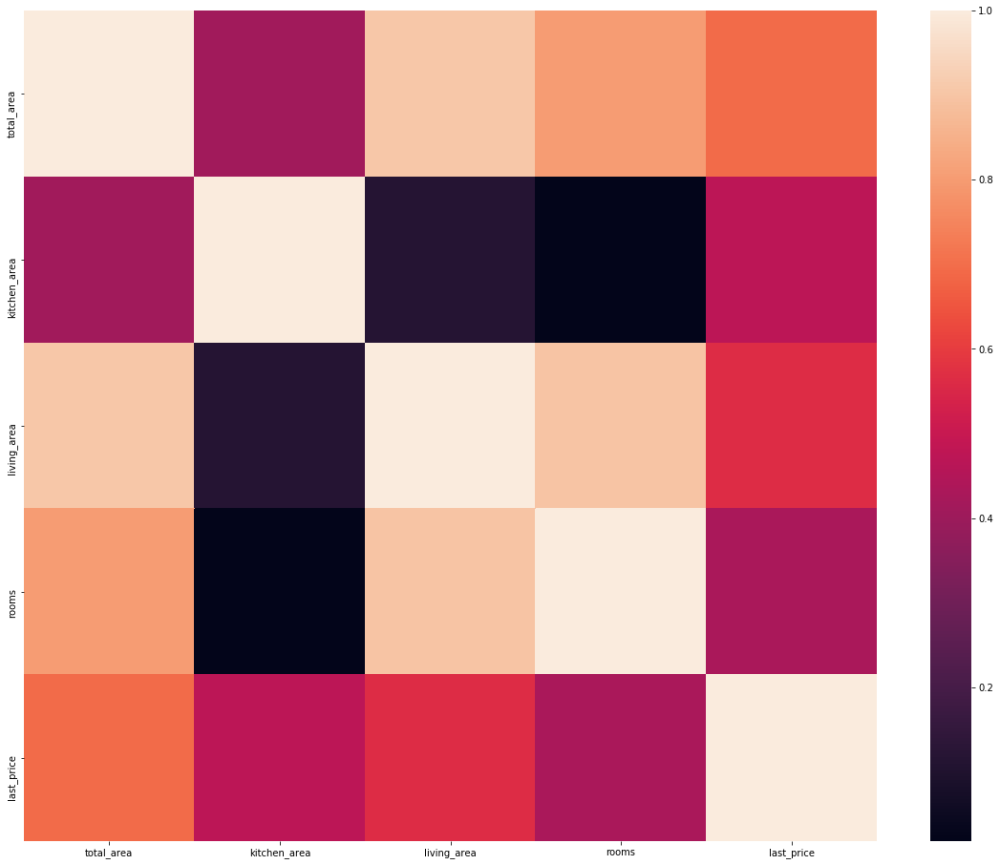

In [23]:
correlation(start_data[['total_area', 'kitchen_area', 'living_area', 'rooms', 'last_price']])

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b>  Использовать heatmap для визуализации корреляционной матрицы, отличная идея, но его можно сделать немного информативнее. Например ты можешь добавить следющие параметры в вызов функции sns.heatmap():
    
- annot=True - добавит подписи значений в ячейках
- fmt = '.2f' - отформатирует их, в данном случае округлив до 2 десятых
- annot_kws={'size':14} - задаст размер шрифта подписей, в данном случае 14.
    
    
Подробнее:
  
- https://seaborn.pydata.org/generated/seaborn.heatmap.html
</div>

Заполнять пропуски в столбцах с жилой площадью и площадью кухни будем основываясь на среднем соотношении этих значений для типов квартир по комнатам. У нас есть примерно 90% датасета, где у нас уже есть все данные по площадям. Оценим насколько правильно они заполнены.

Для этого нам надо сложить жилую площадь с площадью кухни и поделить на общую. Если это значение больше 1, то это значит, что сумма площадей жилой и кухни больше общей площади, чего не может быть. И очень маленьких значений тоже не должно быть, это будет значить, что прочая нежилая площадь, о которой у нас нет данных, сильно больше жилой площади.

In [24]:
start_data['liv_plus_kit_to_tot_ratio'] = (start_data['living_area'] + start_data['kitchen_area']) / start_data['total_area']

In [25]:
info_row(start_data['liv_plus_kit_to_tot_ratio'], start_data)

liv_plus_kit_to_tot_ratio
count    19034.000000
mean         0.751276
std          0.068546
min          0.195876
25%          0.713160
50%          0.750000
75%          0.786494
max          1.575758
Name: liv_plus_kit_to_tot_ratio, dtype: float64


Из графика видно, что данные для многих квартир заполнены не верно. Оставим только те, что находятся в диапозоне от 0.603 (нижняя граница размаха) до 1 (максимальное значение, которое можно считать достоверным). 

Для того, чтобы пока не отбрасывать строки, где нет данных заполним их еденицами. Позже, когда мы расчитаем пропуски в столбцах с жилой площадью и площадью кухни, мы пересчитаем этот столбец еще раз и повторим анализ.

In [26]:
start_data['liv_plus_kit_to_tot_ratio'].fillna(1, inplace=True)
start_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21459 entries, 0 to 21458
Data columns (total 18 columns):
index                        21459 non-null int64
total_images                 21459 non-null int64
last_price                   21459 non-null float64
total_area                   21459 non-null float64
first_day_exposition         21459 non-null object
rooms                        21459 non-null int64
ceiling_height               12970 non-null float64
floors_total                 21459 non-null int64
living_area                  19790 non-null float64
floor                        21459 non-null int64
is_apartment                 21459 non-null bool
studio                       21459 non-null bool
kitchen_area                 19400 non-null float64
balcony                      21459 non-null int64
locality_name                21416 non-null object
cityCenters_nearest          15994 non-null float64
days_exposition              18846 non-null float64
liv_plus_kit_to_tot_ratio  

In [27]:
info_row(start_data['liv_plus_kit_to_tot_ratio'], start_data)

liv_plus_kit_to_tot_ratio
count    21459.000000
mean         0.779384
std          0.101827
min          0.195876
25%          0.718750
50%          0.759375
75%          0.808208
max          1.575758
Name: liv_plus_kit_to_tot_ratio, dtype: float64


In [28]:
start_data = start_data.query('0.603 <= liv_plus_kit_to_tot_ratio <= 1')

In [29]:
info_row(start_data['liv_plus_kit_to_tot_ratio'], start_data)

liv_plus_kit_to_tot_ratio
count    21132.000000
mean         0.781192
std          0.096775
min          0.603059
25%          0.720306
50%          0.760000
75%          0.808511
max          1.000000
Name: liv_plus_kit_to_tot_ratio, dtype: float64


Теперь мы можем посчитать соотношения жилой к общей и кухни к общей там, где есть данные.

In [30]:
def living_to_total_ratio_calc(row):
    if row['living_area'] == row['living_area']:
        return row['living_area'] / row['total_area']
    return row['living_area']

start_data['living_to_total_ratio'] = start_data.apply(living_to_total_ratio_calc, axis=1)

In [31]:
def kitchen_to_total_ratio_calc(row):
    if row['kitchen_area'] == row['kitchen_area']:
        return row['kitchen_area'] / row['total_area']
    return row['kitchen_area']

start_data['kitchen_to_total_ratio'] = start_data.apply(kitchen_to_total_ratio_calc, axis=1)

Соберем данные о средних значениях для каждого типа помещения по количеству комнат.

In [32]:
liv_kit_to_tot_ratio_mean_by_rooms = start_data.pivot_table(index='rooms', 
                                                                values=('living_to_total_ratio', 
                                                                        'kitchen_to_total_ratio'))
print(liv_kit_to_tot_ratio_mean_by_rooms)

       kitchen_to_total_ratio  living_to_total_ratio
rooms                                               
1                    0.250135               0.492240
2                    0.171457               0.584485
3                    0.134457               0.640204
4                    0.114445               0.681050
5                    0.107881               0.686831
6                    0.099138               0.753541


Чем больше квартира, тем меньше соотношение площади кухни к общей, и наоборот для жилой.

Как видим у нас получились довольно реалистичные значения. Жилая площадь это не просто общая минус кухня. В нежилую еще могут входить подсобные помещения, санузлы.

In [33]:
info_row(start_data['kitchen_to_total_ratio'], start_data)
info_row(start_data['living_to_total_ratio'], start_data)

kitchen_to_total_ratio
count    19073.000000
mean         0.189584
std          0.070448
min          0.043524
25%          0.136364
50%          0.175412
75%          0.234899
max          0.724638
Name: kitchen_to_total_ratio, dtype: float64


living_to_total_ratio
count    19463.000000
mean         0.565945
std          0.100918
min          0.086957
25%          0.499110
50%          0.568966
75%          0.636364
max          1.000000
Name: living_to_total_ratio, dtype: float64


Судя по распределению люди часто не понимают как правильно считать жилую площадь - у некоторых вся площадь жилая, у других наоборот жилой площади нет совсем. Пока оставим данные как есть.

В нашем датасете для столбцов с данными о жилой площади и площади кухонь пропущенно примерно по 10% значений. Будем заполнять их на основании полученных соотношений характерных для количества комнат в квартире. Для этого используем сводную таблицу как словарь, а вставлять пропуски будем умножив значение общей площади на коэффициент соотношения.

In [34]:
def filling_missing_data_kitchen_area(row):
    if row['kitchen_area'] != row['kitchen_area']:
        return row['total_area'] * liv_kit_to_tot_ratio_mean_by_rooms['kitchen_to_total_ratio'][row['rooms']]
    return row['kitchen_area']

def filling_missing_data_living_area(row):
    if row['living_area'] != row['living_area']:
        return row['total_area'] * liv_kit_to_tot_ratio_mean_by_rooms['living_to_total_ratio'][row['rooms']]
    return row['living_area']

start_data['kitchen_area'] = start_data.apply(filling_missing_data_kitchen_area, axis=1)
start_data['living_area'] = start_data.apply(filling_missing_data_living_area, axis=1)

print(start_data.info())

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21132 entries, 0 to 21458
Data columns (total 20 columns):
index                        21132 non-null int64
total_images                 21132 non-null int64
last_price                   21132 non-null float64
total_area                   21132 non-null float64
first_day_exposition         21132 non-null object
rooms                        21132 non-null int64
ceiling_height               12754 non-null float64
floors_total                 21132 non-null int64
living_area                  21132 non-null float64
floor                        21132 non-null int64
is_apartment                 21132 non-null bool
studio                       21132 non-null bool
kitchen_area                 21132 non-null float64
balcony                      21132 non-null int64
locality_name                21089 non-null object
cityCenters_nearest          15737 non-null float64
days_exposition              18557 non-null float64
liv_plus_kit_to_tot_ratio  

Пересчитаем столбец соотношения суммы площадей жилой и кухни к общей.

In [35]:
start_data.drop(['liv_plus_kit_to_tot_ratio'], axis='columns', inplace=True)

In [36]:
start_data['liv_plus_kit_to_tot_ratio'] = (start_data['living_area'] + start_data['kitchen_area']) / start_data['total_area']
start_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21132 entries, 0 to 21458
Data columns (total 20 columns):
index                        21132 non-null int64
total_images                 21132 non-null int64
last_price                   21132 non-null float64
total_area                   21132 non-null float64
first_day_exposition         21132 non-null object
rooms                        21132 non-null int64
ceiling_height               12754 non-null float64
floors_total                 21132 non-null int64
living_area                  21132 non-null float64
floor                        21132 non-null int64
is_apartment                 21132 non-null bool
studio                       21132 non-null bool
kitchen_area                 21132 non-null float64
balcony                      21132 non-null int64
locality_name                21089 non-null object
cityCenters_nearest          15737 non-null float64
days_exposition              18557 non-null float64
living_to_total_ratio      

In [37]:
info_row(start_data['liv_plus_kit_to_tot_ratio'], start_data)

liv_plus_kit_to_tot_ratio
count    21132.000000
mean         0.756509
std          0.064939
min          0.337092
25%          0.718750
50%          0.754107
75%          0.786674
max          1.355436
Name: liv_plus_kit_to_tot_ratio, dtype: float64


У нас снова появились значения которые выходят за диапазоны нижней границы и еденицы. Еще появились явные пики - скорее всего это результат заполнения пропусков. Снова отрежем те данные, которые вбиваются за границы 0.6 - 1.

In [38]:
start_data = start_data.query('0.6 <= liv_plus_kit_to_tot_ratio <= 1')

In [39]:
info_row(start_data['liv_plus_kit_to_tot_ratio'], start_data)

liv_plus_kit_to_tot_ratio
count    21004.000000
mean         0.755474
std          0.060840
min          0.603059
25%          0.718750
50%          0.753903
75%          0.785980
max          1.000000
Name: liv_plus_kit_to_tot_ratio, dtype: float64


Посмотрим корреляцию полученных значения между собой.

,total_area,kitchen_area,living_area,rooms,last_price
total_area,1.000000,0.427799,0.923826,0.805774,0.693842
kitchen_area,0.427799,1.000000,0.141080,0.027330,0.483338
living_area,0.923826,0.141080,1.000000,0.900737,0.570165
rooms,0.805774,0.027330,0.900737,1.000000,0.432204
last_price,0.693842,0.483338,0.570165,0.432204,1.000000


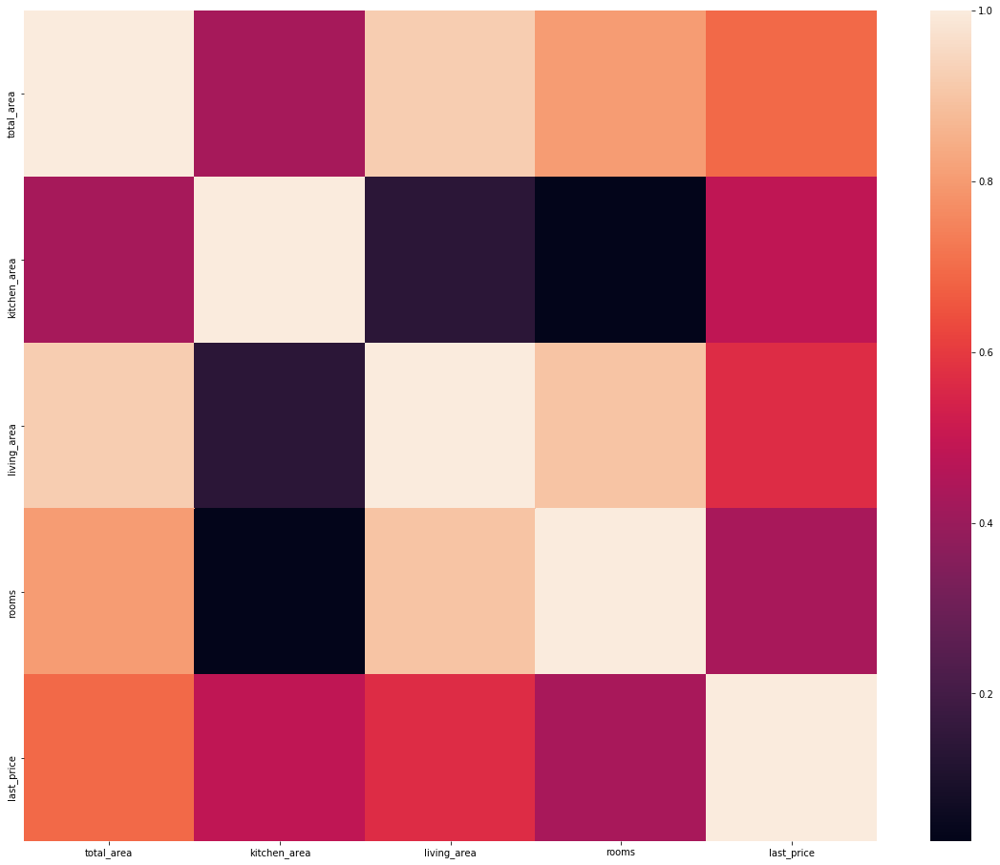

In [40]:
correlation(start_data[['total_area', 'kitchen_area', 'living_area', 'rooms', 'last_price']])

Исходя из анализа корреляций до и после откидывания части данных, которые явно содержали ошибки можно с уверенностью сказать, что это было оправдано. Ошибки, которые мы отбросили, говорят о том, что в момент заполнения формы люди сами не до конца понимали, что является жилой площадью, а что нет.

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fafae5cc6d0>,
      dtype=object)

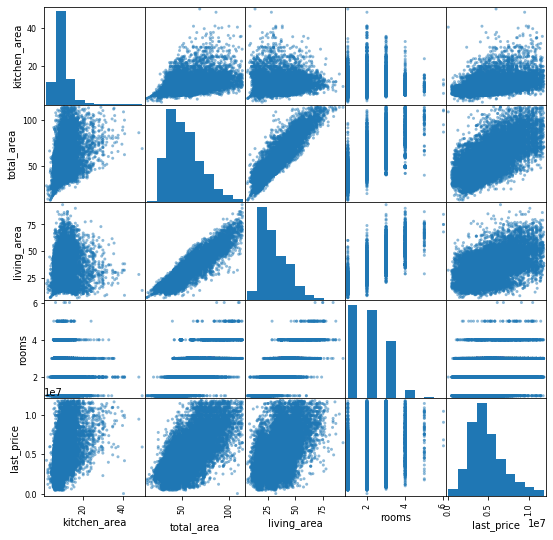

In [41]:
data_for_matrix = start_data[['kitchen_area', 'total_area', 'living_area', 'rooms', 'last_price']]

pd.plotting.scatter_matrix(data_for_matrix, figsize=(9, 9)) 

<div style="border:solid blue 2px; padding: 20px"> <h1 style="color:blue; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-info">
<b>Для размышления:</b> Тут что бы избавиться от вывода в out-поток матрицы объектов matplotlib (matplotlib.axes._subplots.AxesSubplot....)  можно после вызова функции поставить ';' или явно вызвать метод plt.show()
</div>
    

#### 2.7.
Давайте теперь посмотрим еще на одну характеристику, которая нам понадобится для формирования выводов - высота потолков.

In [42]:
info_row(start_data['ceiling_height'], start_data)

ceiling_height
count    12708.000000
mean         2.719854
std          0.946485
min          1.000000
25%          2.500000
50%          2.600000
75%          2.750000
max         32.000000
Name: ceiling_height, dtype: float64


Довольно много аномальных значений. Оставим только то, что попадает в диапозон 2.2 - 5 метров. Но прежде нам надо заполнить пропуски, чтобы не потерять их при обрезании "хвостов". 

Построим таблицу медианных и средних значений высоты потолков в зависимости от количества комнат.

In [43]:
ceiling_height_rooms_median = start_data.pivot_table(index='rooms', values=('ceiling_height'), 
                                                     aggfunc=('mean', 'median', 'count'))
print(ceiling_height_rooms_median)

       count      mean  median
rooms                         
1       4518  2.689480   2.640
2       4552  2.731483   2.600
3       3113  2.727722   2.600
4        476  2.824433   2.600
5         45  2.918889   2.870
6          4  2.987500   2.975


Заменим пропущенные значения на медианные значения по количеству комнат в квартире.

In [44]:
start_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 21004 entries, 0 to 21458
Data columns (total 20 columns):
index                        21004 non-null int64
total_images                 21004 non-null int64
last_price                   21004 non-null float64
total_area                   21004 non-null float64
first_day_exposition         21004 non-null object
rooms                        21004 non-null int64
ceiling_height               12708 non-null float64
floors_total                 21004 non-null int64
living_area                  21004 non-null float64
floor                        21004 non-null int64
is_apartment                 21004 non-null bool
studio                       21004 non-null bool
kitchen_area                 21004 non-null float64
balcony                      21004 non-null int64
locality_name                20961 non-null object
cityCenters_nearest          15648 non-null float64
days_exposition              18441 non-null float64
living_to_total_ratio      

In [45]:
def ceiling_fill_na(row):
    if row['ceiling_height'] != row['ceiling_height']:
        return ceiling_height_rooms_median['median'][row['rooms']]
    return row['ceiling_height']

start_data['ceiling_height'] = start_data.apply(ceiling_fill_na, axis=1)

In [46]:
start_data = start_data.query('2.2 <= ceiling_height <= 5')

In [47]:
info_row(start_data['ceiling_height'], start_data)

ceiling_height
count    20967.000000
mean         2.656834
std          0.178739
min          2.200000
25%          2.600000
50%          2.600000
75%          2.670000
max          5.000000
Name: ceiling_height, dtype: float64


Ожидаемо на графике появилось большое количество пиков, так как для почти половины датасета отсутсвовала информация о высоте потолков и мы заполнили эти ячейки одинаковыми значениями, разбитыми только по количеству комнат.

#### 2.8.
Осталось изменить тип данных для стобца `days_exposition`. Сейчас данные в нем записаны в формате `float64` и имеют пропуски. Чтобы привести тип данных к `int64`, нам необходимо избавиться от пропусков. Мы не можем заполнить эти пропуски значимыми данными, так как это исказит наш анализ. Заполним их значением `-1000` (количество дней размещения объявления не может быть отрицательным), поменяем тип данных. К сожалению в столбце с типом данных `int64` не могут содержаться NaN значения, поэтому оставим отрицательные как альтернативу.

In [48]:
start_data['days_exposition'] = start_data['days_exposition'].fillna(-1000)
start_data['days_exposition'] = start_data['days_exposition'].astype('int')

In [49]:
info_row(start_data['days_exposition'],start_data)

days_exposition
count    20967.000000
mean        29.568274
std        431.657416
min      -1000.000000
25%         24.000000
50%         71.000000
75%        191.000000
max       1580.000000
Name: days_exposition, dtype: float64


### Вывод

Пока мы очищали данные и заполняли пропуски нам пришлось разобраться с аномалиями и явными ошибками. В результате этой работы нам пришлось убрать из датасета ~11.5% строк. Довольно много, но эти плохие данные могли сказаться на результате исследования.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Круто! Ты проделал по истине титанический путь при отчистке данных, молодец! Правда не все данные дошли до конца и порядка ~10% были отброшенные на самом первом этапе с фильтрацией по стоимсти и площади, при этом на последующих этапах ты потерял всего ~1.5%, возможно стоит пересмотреть первый отсев хвостов?
</div>

### Шаг 3. Посчитайте и добавьте в таблицу
<a class="anchor" id="fourth-bullet"></a>

#### 3.1.

Перед тем, как переходить к добавлению новых данных в таблицу преобразуем формат времени в нашей таблице.

In [50]:
print(start_data['first_day_exposition'].head(1))

0    2018-12-04T00:00:00
Name: first_day_exposition, dtype: object


In [51]:
start_data['first_day_exposition'] = pd.to_datetime(
    start_data['first_day_exposition'], format='%Y-%m-%d')

print(start_data['first_day_exposition'].head(1))

0   2018-12-04
Name: first_day_exposition, dtype: datetime64[ns]


#### 3.2.
Продолжим работать с датой и добавим в таблицу 3 новых столбца: день недели, месяц и год.

In [52]:
def weekdays_add(row):
    weekdays = {0:'1 - Понедельник',
                1:'2 - Вторник',
                2:'3 - Среда',
                3:'4 - Четверг',
                4:'5 - Пятница',
                5:'6 - Суббота',
                6:'7 - Воскресенье'}
    return weekdays[row['first_day_exposition'].weekday()]

start_data['weekday'] = start_data.apply(weekdays_add, axis=1)
print(start_data['weekday'].head())

0        2 - Вторник
1        4 - Четверг
2        2 - Вторник
3    1 - Понедельник
4        4 - Четверг
Name: weekday, dtype: object


In [53]:
start_data['year'] = start_data['first_day_exposition'].dt.year
start_data['month'] = start_data['first_day_exposition'].dt.month
print(start_data['year'], start_data['month'])

0        2018
1        2015
2        2018
3        2018
4        2017
         ... 
21454    2016
21455    2018
21456    2018
21457    2017
21458    2017
Name: year, Length: 20967, dtype: int64 0        12
1         8
2         6
3         9
4        11
         ..
21454     8
21455     1
21456     2
21457     3
21458     7
Name: month, Length: 20967, dtype: int64


<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Отлично! День недели, месяц и год добавлены!

#### 3.3.
Теперь добавим в датасет цену квадратного метра для каждой квартиры.

In [54]:
start_data['sq_meter_price'] = start_data['last_price'] / start_data['total_area']
print(start_data['sq_meter_price'].head(5))
info_row(start_data['sq_meter_price'], start_data)

0     82920.792079
1     92785.714286
2    100000.000000
3     95065.789474
4     99195.710456
Name: sq_meter_price, dtype: float64
sq_meter_price
count     20967.000000
mean      91913.237791
std       29451.496820
min         111.834862
25%       74603.174603
50%       92592.583333
75%      109183.673469
max      312240.000000
Name: sq_meter_price, dtype: float64


<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Стоимость квадратного метра определена!

#### 3.4.
Добавим этаж квартиры: первый, последний, другой.

In [55]:
def floors_identification(row):
    if row['floor'] == 1:
        return "Первый"
    elif row['floor'] == row['floors_total']:
        return 'Последний'
    return 'Другой'

start_data['floor_ident'] = start_data.apply(floors_identification, axis=1)

print(start_data['floor_ident'].head(15))

0        Первый
1        Другой
2        Другой
3        Другой
4        Другой
5        Другой
6        Другой
7        Другой
8        Другой
9        Другой
10    Последний
11    Последний
12       Первый
13       Другой
14       Первый
Name: floor_ident, dtype: object


<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Этажность категоризирована!

#### 3.5.
Еще раз посчитаем отношения жилой площади к общей и площади кухни к общей.

In [56]:
start_data['living_to_total_ratio'] = start_data['living_area'] / start_data['total_area']
start_data['kitchen_to_total_ratio'] = start_data['kitchen_area'] / start_data['total_area']

In [57]:
info_row(start_data['living_to_total_ratio'], start_data)
info_row(start_data['kitchen_to_total_ratio'], start_data)

living_to_total_ratio
count    20967.000000
mean         0.565020
std          0.096611
min          0.134615
25%          0.492537
50%          0.571429
75%          0.636150
max          0.901675
Name: living_to_total_ratio, dtype: float64


kitchen_to_total_ratio
count    20967.000000
mean         0.190451
std          0.068684
min          0.043524
25%          0.136364
50%          0.175000
75%          0.241935
max          0.724638
Name: kitchen_to_total_ratio, dtype: float64


<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Отлично! Соотношения площадей посчитаны верно и пора переходить к самому интересному!

### Шаг 4. Проведите исследовательский анализ данных и выполните инструкции:
<a class="anchor" id="fifth-bullet"></a>

#### 4.1.


Посмотрим на время продажи квартиры. Надо учесть, что у нас там содержатся данные, которые мы добавили для преобразования типа. Сделаем срез и уберем лишнее.

In [58]:
days_exposition_df = start_data.query('days_exposition > 0')
info_row(days_exposition_df['days_exposition'], days_exposition_df)

days_exposition
count    18410.000000
mean       172.566974
std        211.007909
min          1.000000
25%         44.000000
50%         91.000000
75%        218.000000
max       1580.000000
Name: days_exposition, dtype: float64


In [59]:
first_month_sale = days_exposition_df[days_exposition_df['days_exposition']<=31]['days_exposition'].count()
first_month_sale_ratio = first_month_sale / days_exposition_df['days_exposition'].count() * 100
print(first_month_sale_ratio)

19.20152091254753


Среднее время продажи квартиры - 172 дня

Медиана - 91, то есть половина квартир продается быстрее чем за 3 месяца. 
Быстрой продажей можно считать продажу в первый месяц после размещения объявления. На этот период приходится 19% всех продаж.
Все, что находится за третьей квартилью (>218 дней) долгая продажа. Попробуем чуть ближе посмотреть на быстро проданные квартиры и на те, что продавались очень долго.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Молодец, время продажи изучено и статистики расчитаны верно!

In [60]:
long_sale = days_exposition_df.query('days_exposition >= 218')
quick_sale = days_exposition_df.query('days_exposition < 32')
info_row(long_sale['last_price'], long_sale)
info_row(long_sale['sq_meter_price'], long_sale)
info_row(long_sale['locality_name'], long_sale)
info_row(long_sale['rooms'], long_sale)

last_price
count    4.618000e+03
mean     4.916016e+06
std      2.246682e+06
min      4.500000e+05
25%      3.350000e+06
50%      4.500000e+06
75%      6.132500e+06
max      1.186686e+07
Name: last_price, dtype: float64


sq_meter_price
count      4618.000000
mean      90179.323048
std       29241.271604
min       10561.797753
25%       72881.355932
50%       90000.000000
75%      106523.910149
max      262711.864407
Name: sq_meter_price, dtype: float64


locality_name
['Санкт-Петербург' 'Петергоф' 'Парголово' 'Фёдоровское' 'Кировск'
 'Девяткино' 'Молодцово' 'Пушкин' 'Всеволожск' 'Кронштадт' 'Шушары'
 'Торковичи' 'Понтонный' 'Ломоносов' 'Павловск' 'Приозерск' 'Сланцы'
 'Село' 'Сертолово' 'Путилово' 'Ивангород' 'Сестрорецк' 'Сясьстрой'
 'Колпино' 'Оржицы' 'Бугры' 'Кузьмоловский' 'Мурино' 'Луга' 'Отрадное'
 'Копорье' 'Выборг' 'Синявино' 'Тосно' 'Кудрово' 'Волосово' 'Пикалёво'
 'Кириши' 'Гатчина' 'Вырица' 'Вартемяги' 'Севастьяново' 'Ижора' 'Янино-1'
 'Старая' 'Волхов' 'Никольское' 'Горбунки' 'Иссад' 'Романовка' 'Мистолово'
 'Нурма' 'Зимитицы' 'Барышево' 'Бокситогорск' 'Ильичёво' 'Верево'
 'Калитино' 'Подпорожье' 'Ульяновка' 'Войсковицы' 'Первомайское'
 'Приладожский' 'Свердлова' 'Лебяжье' 'Кузьмолово' 'Коммунар' None 'Рахья'
 'Сиверский' 'Щеглово' 'Победа' 'Елизаветино' 'Новоселье' 'Кингисепп'
 'Металлострой' 'Сапёрный' 'Стрельна' 'Гаврилово' 'Глажево' 'Запорожское'
 'Юкки' 'Мануйлово' 'Лесколово' 'Цвылёво' 'Зеленогорск' 'Гостилицы'
 'Павл

In [61]:
info_row(quick_sale['last_price'], quick_sale)
info_row(quick_sale['sq_meter_price'], quick_sale)
info_row(quick_sale['locality_name'], quick_sale)
info_row(quick_sale['rooms'], quick_sale)


last_price
count    3.535000e+03
mean     4.712765e+06
std      1.950023e+06
min      1.219000e+04
25%      3.400000e+06
50%      4.300000e+06
75%      5.700000e+06
max      1.189440e+07
Name: last_price, dtype: float64


sq_meter_price
count      3535.000000
mean      96037.002248
std       27185.806813
min         111.834862
25%       80663.489736
50%       95588.235294
75%      111012.023092
max      312240.000000
Name: sq_meter_price, dtype: float64


locality_name
['Ломоносов' 'Санкт-Петербург' 'Парголово' 'Мурино' 'Сертолово' 'Шушары'
 'Всеволожск' 'Выборг' 'Колпино' 'Девяткино' 'Бугры' 'Петергоф' 'Бор'
 'Волосово' 'Павлово' 'Янино-1' 'Кудрово' 'Село' 'Стрельна' 'Кириши'
 'Кингисепп' 'Токсово' 'Свет' 'Бокситогорск' 'Тихвин' 'Сланцы' 'Заневка'
 'Понтонный' 'Волхов' 'Тельмана' 'Тосно' 'Гатчина' 'Новогорелово'
 'Сестрорецк' 'Песочный' 'Отрадное' 'Пушкин' 'Коммунар' 'Щеглово'
 'Никольское' 'Колпаны' 'Лаголово' 'Романовка' 'Приозерск' 'Кронштадт'
 'Зимитицы' 'Плодовое' 'Металлострой' 'Бегуницы' 'Кировск' 'Парицы'
 'Селезнёво' 'Мистолово' 'Кузьмоловский' 'Важины' 'Свердлова' 'Агалатово'
 'Лебяжье' 'Зеленогорск' 'Победа' 'Старая' 'Шлиссельбург' 'Хинколово'
 'Дубровка' 'Пикалёво' 'Учхоз' 'километр' 'Колтуши' 'Сясьстрой'
 'Кузнечное' 'Рахья' 'Нурма' 'Любань' None 'Мичуринское' 'Новоселье'
 'Первомайское' 'Аннино' 'Русско-Высоцкое' 'Торосово' 'Войсковицы'
 'Павловск' 'Сиверский' 'Пустошь' 'Ивангород' 'Жилгородок' 'Батово' 'Юкки'
 'Счастье' 

In [62]:
display(long_sale[['days_exposition',
                   'last_price', 
                    'total_area', 
                    'rooms', 
                    'living_area', 
                    'kitchen_area', 
                    'sq_meter_price', 
                    'locality_name',
                    'cityCenters_nearest',
                    'total_images', 
                    'year']].corr())
display(quick_sale[['days_exposition',
                   'last_price', 
                    'total_area', 
                    'rooms', 
                    'living_area', 
                    'kitchen_area', 
                    'sq_meter_price', 
                    'locality_name',
                    'cityCenters_nearest',
                    'total_images', 
                    'year']].corr())

,days_exposition,last_price,total_area,rooms,living_area,kitchen_area,sq_meter_price,cityCenters_nearest,total_images,year
days_exposition,1.000000,0.091408,0.065520,0.036431,0.045688,0.069693,0.052863,-0.055295,-0.085813,-0.552757
last_price,0.091408,1.000000,0.703932,0.436493,0.579989,0.500442,0.623667,-0.407439,0.089368,-0.046860
total_area,0.065520,0.703932,1.000000,0.816995,0.930540,0.414936,-0.074882,-0.184755,0.065941,-0.056502
rooms,0.036431,0.436493,0.816995,1.000000,0.909856,0.019877,-0.252632,-0.117394,0.056811,-0.043724
living_area,0.045688,0.579989,0.930540,0.909856,1.000000,0.141894,-0.176156,-0.159760,0.064864,-0.044654
kitchen_area,0.069693,0.500442,0.414936,0.019877,0.141894,1.000000,0.264907,-0.158576,0.029421,-0.043219
sq_meter_price,0.052863,0.623667,-0.074882,-0.252632,-0.176156,0.264907,1.000000,-0.403194,0.065771,-0.005281
cityCenters_nearest,-0.055295,-0.407439,-0.184755,-0.117394,-0.159760,-0.158576,-0.403194,1.000000,-0.017192,0.050489
total_images,-0.085813,0.089368,0.065941,0.056811,0.064864,0.029421,0.065771,-0.017192,1.000000,0.187341
year,-0.552757,-0.046860,-0.056502,-0.043724,-0.044654,-0.043219,-0.005281,0.050489,0.187341,1.000000


,days_exposition,last_price,total_area,rooms,living_area,kitchen_area,sq_meter_price,cityCenters_nearest,total_images,year
days_exposition,1.000000,0.031974,0.017836,0.020311,0.014580,0.012891,0.012728,0.037135,0.029375,-0.050283
last_price,0.031974,1.000000,0.709754,0.473862,0.591176,0.447235,0.564672,-0.332018,0.184339,0.039477
total_area,0.017836,0.709754,1.000000,0.799087,0.920501,0.433998,-0.135424,-0.120457,0.113883,-0.038304
rooms,0.020311,0.473862,0.799087,1.000000,0.897870,0.031332,-0.238158,-0.067734,0.073736,-0.012692
living_area,0.014580,0.591176,0.920501,0.897870,1.000000,0.142195,-0.206865,-0.098496,0.085440,-0.031449
kitchen_area,0.012891,0.447235,0.433998,0.031332,0.142195,1.000000,0.136756,-0.102116,0.081095,-0.030085
sq_meter_price,0.012728,0.564672,-0.135424,-0.238158,-0.206865,0.136756,1.000000,-0.375231,0.117158,0.117485
cityCenters_nearest,0.037135,-0.332018,-0.120457,-0.067734,-0.098496,-0.102116,-0.375231,1.000000,-0.029845,-0.002775
total_images,0.029375,0.184339,0.113883,0.073736,0.085440,0.081095,0.117158,-0.029845,1.000000,0.091608
year,-0.050283,0.039477,-0.038304,-0.012692,-0.031449,-0.030085,0.117485,-0.002775,0.091608,1.000000


Как видно из матриц корреляций, долгая или быстрая продажа не зависит ни от одного из значимых параметров. Значит причина кроется в самих квартирах. Возможно долгопродаваемые квартиры в плохом состоянии или вредные владельцы продовали их неспеша.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Хорошая идея сравнить ликвидные и менее ликвидные квартиры, но для большей наглядности результатов хорошо было бы отразить гистограммы для каждой выборки на одном графике, попробуй написать такую функцию, она тебе еще пригодиться в дальнейшем, сравнение распределений для разных групп одна из наиболее часто встречающихся задача в аналитике данных.

#### 4.2.

Выведем матрицу распределений значений по следующим параметрам:
- количество комнат
- общая площадь
- растояние до центра
- цена

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7fafa5ac7690>,
      dtype=object)

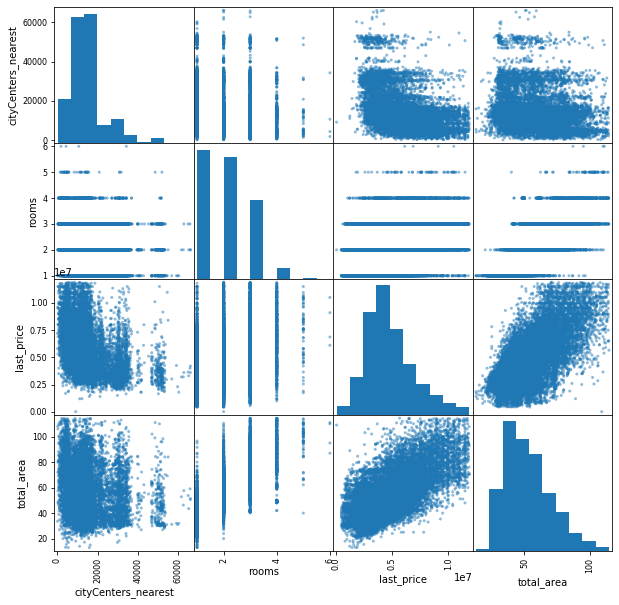

In [63]:
data_for_matrix = start_data[['cityCenters_nearest', 'rooms', 'last_price', 'total_area']]

pd.plotting.scatter_matrix(data_for_matrix, figsize=(10, 10)) 

Из данных матрицы, видно, что чем ближе к центру тем выше цена. И естественно очень высокая зависимость цены от общей площади.

,cityCenters_nearest,rooms,last_price,total_area
cityCenters_nearest,1.000000,-0.074927,-0.346818,-0.126507
rooms,-0.074927,1.000000,0.432575,0.805886
last_price,-0.346818,0.432575,1.000000,0.694026
total_area,-0.126507,0.805886,0.694026,1.000000


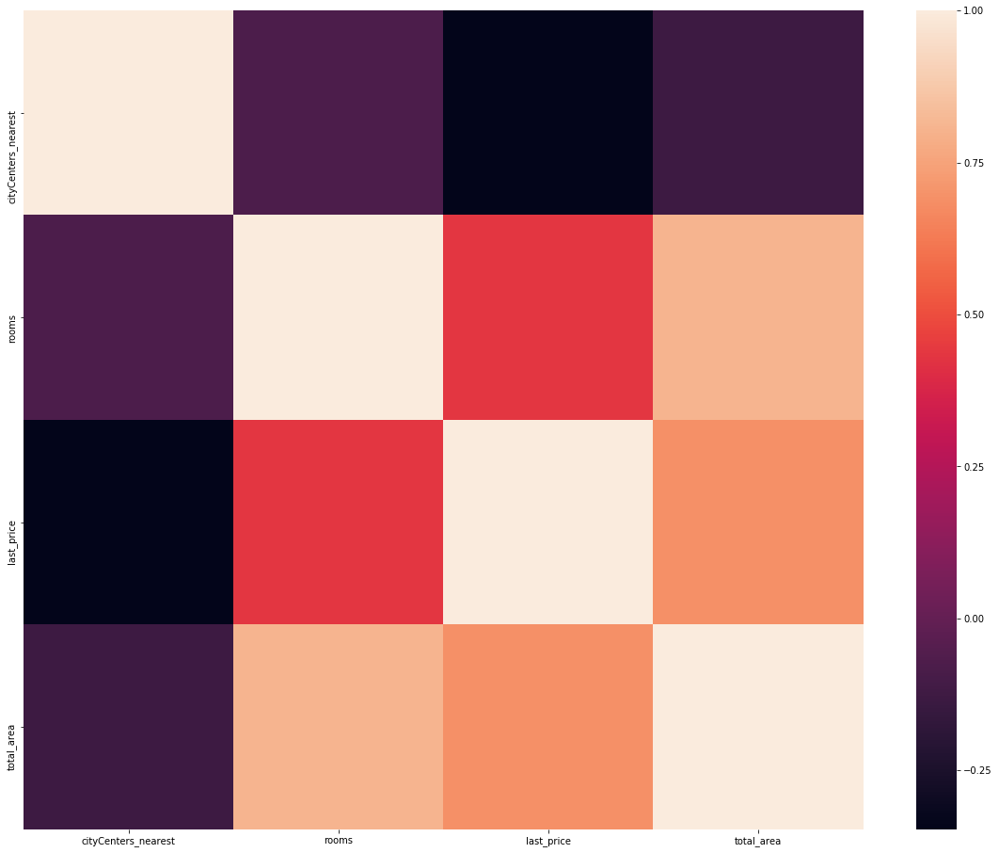

In [64]:
correlation(start_data[['cityCenters_nearest', 'rooms', 'last_price', 'total_area']])

Матрица корреляций подтверждает наши выводы.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Оценка зависимости стоимости квартиры выполнена корректно.
</div> 

<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b>  Подобный анализ можно было бы провести и для стоимости квадратного метра, попробуй это сделать самостоятельно, могут быть определены интересные зависимости.
</div>


Посмотрим как цена квадратного метра зависит от этажа.

In [65]:
start_data.pivot_table(index='floor_ident', values='sq_meter_price', aggfunc='median')

,sq_meter_price
floor_ident,
Другой,96000.000000
Первый,80140.438442
Последний,84523.809524


<div style="border:solid orange 2px; padding: 20px"> <h1 style="color:orange; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b>  А вот зависимость от этажа ты делаешь для стоимости квадратного метра, что не совсем соответствует заданию.


Первый и последний не очень ценятся, хотя лучше последний чем первый, там соседи сверху не зальют и металические шары по полу не катают.

                 count          mean
weekday                             
1 - Понедельник   3186  91911.686209
2 - Вторник       3699  92552.920804
3 - Среда         3510  92331.005118
4 - Четверг       3755  91636.468777
5 - Пятница       3568  92022.967108
6 - Суббота       1725  90439.896970
7 - Воскресенье   1524  91494.378820


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fafac1cc910>,
      dtype=object)

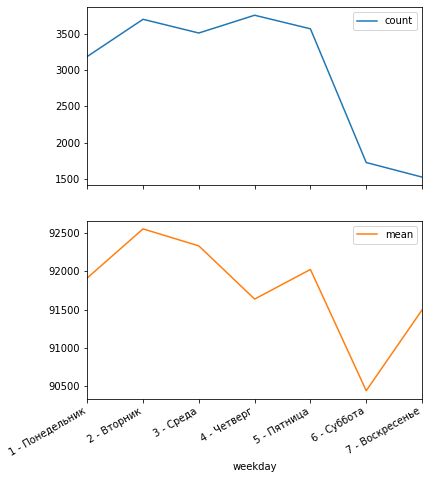

In [66]:
data_by_year_weekday = start_data.pivot_table(
              index=('weekday'), 
              values='sq_meter_price', 
              aggfunc=('mean', 'count'))
print(data_by_year_weekday)
data_by_year_weekday.plot(kind='line',figsize=(6,8), subplots=True)

Самая дорогая оценка квартир начинается во вторник и идет на спад к выходным. Реже всего квартиры на продажу выставляют в выходные, но при этом цена самая низкая в субботу. 

       count          mean
month                     
1       1322  91724.578290
2       2337  91495.467341
3       2294  92075.711985
4       2117  93454.769528
5       1123  91873.275051
6       1577  89643.175039
7       1482  91746.066226
8       1547  92827.384638
9       1737  93036.927709
10      1881  91535.721276
11      2096  91979.004750
12      1454  90997.378614


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fafade4a7d0>,
      dtype=object)

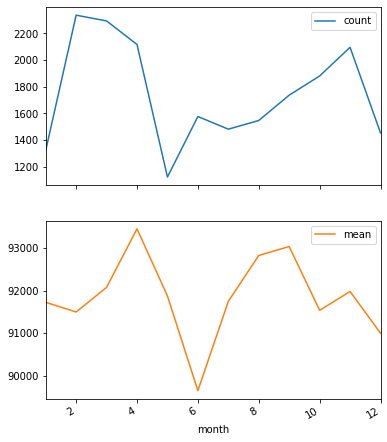

In [67]:
data_by_year_weekday = start_data.pivot_table(
              index=('month'), 
              values='sq_meter_price', 
              aggfunc=('mean', 'count'))
print(data_by_year_weekday)
data_by_year_weekday.plot(kind='line',figsize=(6,8), subplots=True)

Самое лучшее время для покупки квартиры - начало лета. Дальше хорошую сделку можно найти на новогодних праздниках, немного дороже. А вот весной и осенью лучше не торопиться с преобретением жилья.

      count          mean
year                     
2014     82  95973.949911
2015    982  90980.152974
2016   2423  89403.070157
2017   7277  90063.600555
2018   7666  92202.609243
2019   2537  98971.549064


array([<matplotlib.axes._subplots.AxesSubplot object at 0x7fafa7ff3bd0>,
      dtype=object)

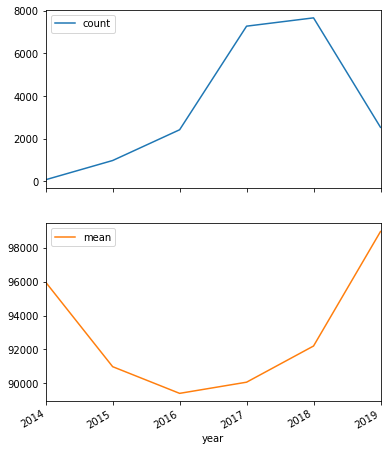

In [68]:
data_by_year_weekday = start_data.pivot_table(
              index=('year'), 
              values='sq_meter_price', 
              aggfunc=('mean', 'count'))
print(data_by_year_weekday)
data_by_year_weekday.plot(kind='line',figsize=(6,8), subplots=True)

Практически наглядная демонстрация закона про спрос и предложение. Больше предложений - ниже цена. Коррективы могут вносить внешние факторы, типа кризисов и обвалов курсов рубля.

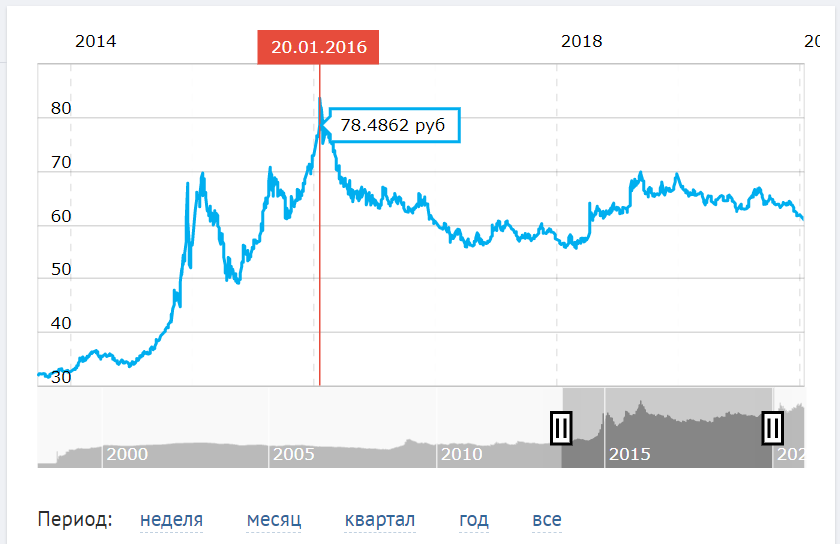

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Отличный анализ завистимости стоимости от времени размещения!
</div> 
    
<div class="alert alert-block alert-info">
<b>Для размышления:</b> Хорошая идея поискать зависимость размера предложения и стоимости квартир от внешних факторов, можно сделать агрегированную таблицу например со средней стоимостью квартир по месяцам и количеством объявлений и добавить средневзвещенный курс рубля, после чего посмотреть на корреляции этих величин.
</div>   


#### 4.3.

Пострим сколько объявлений у нас есть для каждого населенного пункта. Выделим топ-10 с наибольшим количесвтом объявлений.

In [69]:
data_by_locality = start_data.pivot_table(index='locality_name',
                                         values='sq_meter_price',
                                          aggfunc=['count','min', 'mean', 'max']
                                         )

data_by_locality.columns=['count', 'min', 'mean', 'max']

big_cities_stat = data_by_locality.query('count > 230')

data_by_locality_count = big_cities_stat.sort_values(by='count', ascending=False).iloc[:10,:]
data_by_locality_price = big_cities_stat.sort_values(by='mean', ascending=False).iloc[:10,:]
display(data_by_locality_count)
display(data_by_locality_price['mean'])


,count,min,mean,max
locality_name,,,,
Санкт-Петербург,13283,111.834862,105545.227318,312240.000000
Мурино,566,50000.000000,85740.043093,138580.246914
Кудрово,457,63723.323077,95109.920616,142857.142857
Шушары,430,47700.416089,78524.787443,134000.000000
Всеволожск,381,31400.000000,67219.785786,136423.841060
Пушкин,333,59836.065574,100418.157954,166666.666667
Колпино,331,50819.672131,75343.112160,118694.362018
Парголово,319,48405.466970,90632.210984,138522.427441
Гатчина,295,18103.448276,68700.578919,130853.994490


locality_name
Санкт-Петербург    105545.227318
Пушкин             100418.157954
Кудрово             95109.920616
Парголово           90632.210984
Мурино              85740.043093
Шушары              78524.787443
Колпино             75343.112160
Гатчина             68700.578919
Всеволожск          67219.785786
Name: mean, dtype: float64

Из двух таблиц видно, что самая большая цена за квадратный метр в Санкт-Петербурге, а самая маленькая - в Всеволожске.

#### 4.4.


Посмотрим как в Санкт-Петербурге цена меняется в зивсисимоти удаления от центра. Для начала построим сводную таблицу, в которой оставим данные только по Санкт-Петербургу, посчитаем и добавим в таблицу растояние от центра в километрах, округлив их до целых значений. Для каждого километра найдем среднюю цену за квадратный метр и построим график зависимости цены от удаленности от центра.

/opt/conda/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,count,mean,median,round_distance_from_center
round_distance_from_center,,,,
0.0,38,122827.709256,110193.046530,0.0
1.0,120,116313.119164,113290.598291,1.0
2.0,178,114120.486291,108889.692448,2.0
3.0,331,110837.533949,103488.372093,3.0
4.0,523,120540.432320,117045.454545,4.0
5.0,486,121303.474037,117767.825192,5.0
6.0,311,119245.022996,114473.684211,6.0
7.0,299,118073.345724,117336.152220,7.0
8.0,534,111654.160488,107682.649862,8.0


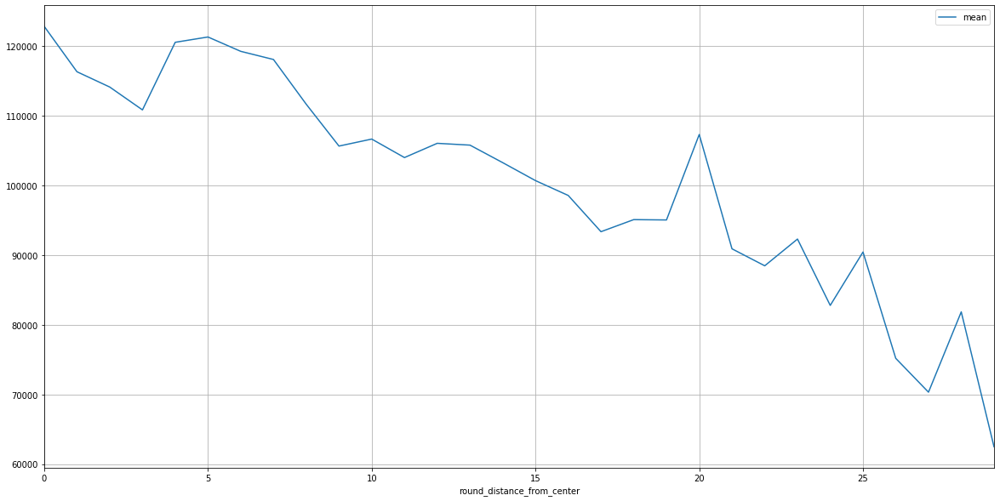

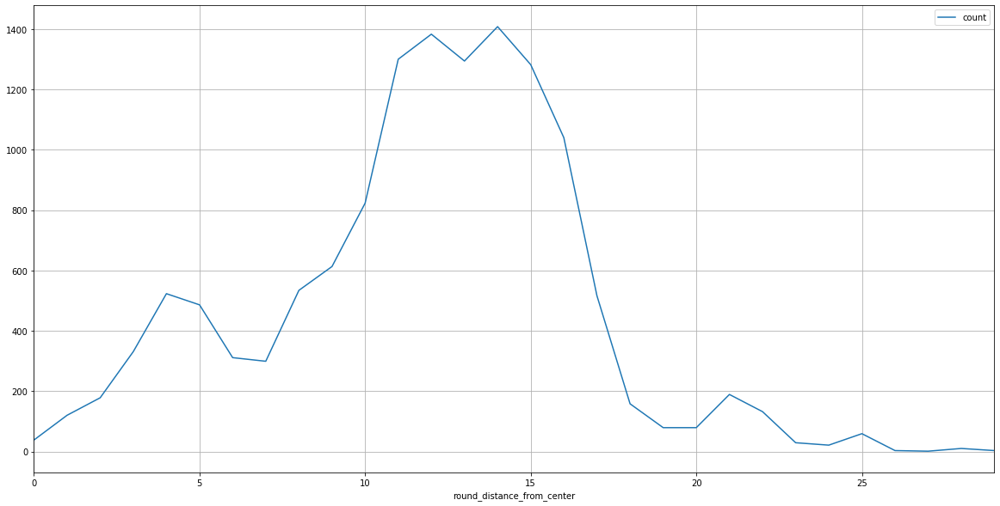

In [70]:
spb_start_data = start_data.query('locality_name == "Санкт-Петербург"')
spb_start_data['round_distance_from_center'] = spb_start_data['cityCenters_nearest'] // 1000

spb_sqmp_per_km = spb_start_data.pivot_table(index='round_distance_from_center', values='sq_meter_price', aggfunc=('mean', 'median', 'count'))
spb_sqmp_per_km['round_distance_from_center'] = spb_sqmp_per_km.index
spb_sqmp_per_km.plot(x='round_distance_from_center', y='mean', figsize=(20,10), grid=True)
spb_sqmp_per_km.plot(x='round_distance_from_center', y='count', figsize=(20,10), grid=True)
#spb_sqmp_per_km.plot(x='cityCenters_nearest', y='sq_meter_price', figsize=(20,10), grid=True)
display(spb_sqmp_per_km)

Исходя из анализа графика, видно, что цена за квадратный метр сильно меняется на удалении в 7 км от центра. Эту зону и будем счиать центральной. Эти данные немного смазаны тем, что в центре гораздо меньше квартир на продажу, в сравнении с тем, что происходит на удалении в 10-15 километров.

<div style="border:solid orange 2px; padding: 20px"> <h1 style="color:orange; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b>  Немного не очевидные выводы о центральной зоне, во-первых, этот анализ также полезно провести как для стоимости квартиры так и для стоимости квадратного метра, во-вторых, первое падение стоимсоти наблюдаеся нар адиусе 3-4 км, что кажется больше подходит под определение центра.
    

#### 4.5.


Сделаем срез таблицы и выделим квартиры, которые находятся в центре.

In [71]:
cityCenter_flats = start_data.query('locality_name == "Санкт-Петербург" and cityCenters_nearest <= 7000')
display(cityCenter_flats)

,index,total_images,last_price,total_area,first_day_exposition,rooms,ceiling_height,floors_total,living_area,floor,...,cityCenters_nearest,days_exposition,living_to_total_ratio,kitchen_to_total_ratio,liv_plus_kit_to_tot_ratio,weekday,year,month,sq_meter_price,floor_ident
21,24,8,6500000.0,97.2,2015-10-31,2,2.60,3,46.5,1,...,2336.0,265,0.478395,0.201646,0.680041,6 - Суббота,2015,10,66872.427984,Первый
54,61,18,7990000.0,74.0,2017-08-24,2,2.60,4,43.0,4,...,4288.0,609,0.581081,0.270270,0.851351,4 - Четверг,2017,8,107972.972973,Последний
90,99,32,9600000.0,90.0,2017-09-26,4,2.60,5,67.0,2,...,2818.0,104,0.744444,0.088889,0.833333,2 - Вторник,2017,9,106666.666667,Другой
101,111,4,4590000.0,40.0,2017-05-29,1,2.64,6,18.0,1,...,6175.0,31,0.450000,0.250000,0.700000,1 - Понедельник,2017,5,114750.000000,Первый
104,114,5,4000000.0,21.4,2019-02-07,1,2.90,8,8.3,7,...,5791.0,-1000,0.387850,0.294393,0.682243,4 - Четверг,2019,2,186915.887850,Другой
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21410,23648,14,10100000.0,78.0,2017-05-12,3,3.27,5,48.6,5,...,1113.0,621,0.623077,0.105128,0.728205,5 - Пятница,2017,5,129487.179487,Последний
21426,23664,5,9000000.0,110.0,2015-12-10,4,3.36,7,64.6,5,...,5016.0,816,0.587273,0.143636,0.730909,4 - Четверг,2015,12,81818.181818,Другой
21427,23665,11,4250000.0,47.0,2016-05-20,1,2.64,6,18.2,1,...,4946.0,131,0.387234,0.310638,0.697872,5 - Пятница,2016,5,90425.531915,Первый
21451,23690,3,5500000.0,52.0,2018-07-19,2,2.60,5,31.0,2,...,6263.0,15,0.596154,0.115385,0.711538,4 - Четверг,2018,7,105769.230769,Другой


Нам надо проанализировать следующие параметры:
- площадь
- цена
- число комнат
- высота потолков

Сделаем список с этими колонками и посмотрим на каждый из параметров ближе.

In [72]:
parametrs_list = ['total_area', 'last_price', 'rooms', 'ceiling_height']
for column in parametrs_list:
    info_row(cityCenter_flats[column], cityCenter_flats)
    info_row(start_data[column], start_data)

total_area
count    1987.000000
mean       65.111696
std        20.803853
min        13.000000
25%        48.000000
50%        64.000000
75%        80.000000
max       114.200000
Name: total_area, dtype: float64


total_area
count    20967.000000
mean        52.656048
std         17.636804
min         13.000000
25%         39.000000
50%         49.000000
75%         63.000000
max        114.500000
Name: total_area, dtype: float64


last_price
count    1.987000e+03
mean     7.380762e+06
std      2.068034e+06
min      1.686000e+06
25%      5.850000e+06
50%      7.300000e+06
75%      8.900000e+06
max      1.187925e+07
Name: last_price, dtype: float64


last_price
count    2.096700e+04
mean     4.801790e+06
std      2.176114e+06
min      1.219000e+04
25%      3.300000e+06
50%      4.400000e+06
75%      5.950000e+06
max      1.189440e+07
Name: last_price, dtype: float64


rooms
count    1987.000000
mean        2.312531
std         0.956485
min         1.000000
25%         2.000000
50%         2.000000
75%         3.000000
max         6.000000
Name: rooms, dtype: float64


rooms
count    20967.000000
mean         1.928936
std          0.874019
min          1.000000
25%          1.000000
50%          2.000000
75%          3.000000
max          6.000000
Name: rooms, dtype: float64


ceiling_height
count    1987.000000
mean        2.875164
std         0.328812
min         2.400000
25%         2.600000
50%         2.750000
75%         3.080000
max         4.370000
Name: ceiling_height, dtype: float64


ceiling_height
count    20967.000000
mean         2.656834
std          0.178739
min          2.200000
25%          2.600000
50%          2.600000
75%          2.670000
max          5.000000
Name: ceiling_height, dtype: float64


Посмотрим как цена коррелируется с такими параметрами как:
- число комнат
- этаж
- удалённость от центра

In [73]:
correlation_list = ['rooms', 'floor', 'cityCenters_nearest']
for factor in correlation_list:
    print('Коэффициент корреляции между "{}" и "last_price" равен {:.2}'.format(
        factor,
        (cityCenter_flats[factor].corr(cityCenter_flats['last_price']))
    )
         )

Коэффициент корреляции между "rooms" и "last_price" равен 0.44
Коэффициент корреляции между "floor" и "last_price" равен 0.13
Коэффициент корреляции между "cityCenters_nearest" и "last_price" равен -0.14


In [74]:
correlation_list = ['rooms', 'floor', 'cityCenters_nearest']
for factor in correlation_list:
    print('Коэффициент корреляции между "{}" и "sq_meter_price" равен {:.2}'.format(
        factor,
        (cityCenter_flats[factor].corr(cityCenter_flats['sq_meter_price']))
    )
         )

Коэффициент корреляции между "rooms" и "sq_meter_price" равен -0.54
Коэффициент корреляции между "floor" и "sq_meter_price" равен 0.24
Коэффициент корреляции между "cityCenters_nearest" и "sq_meter_price" равен 0.067


Общая цена хорошо коррелируется с количеством комнат, в то время как цена квадратного метра снижается с увеличением комнат. Этаж оказывает незначительное влияние как на общую цену, так и на цену за квадратный метр. 

При удалении от центра общая цена немного снижается, а вот цена за квадратный метр почти не меняется.

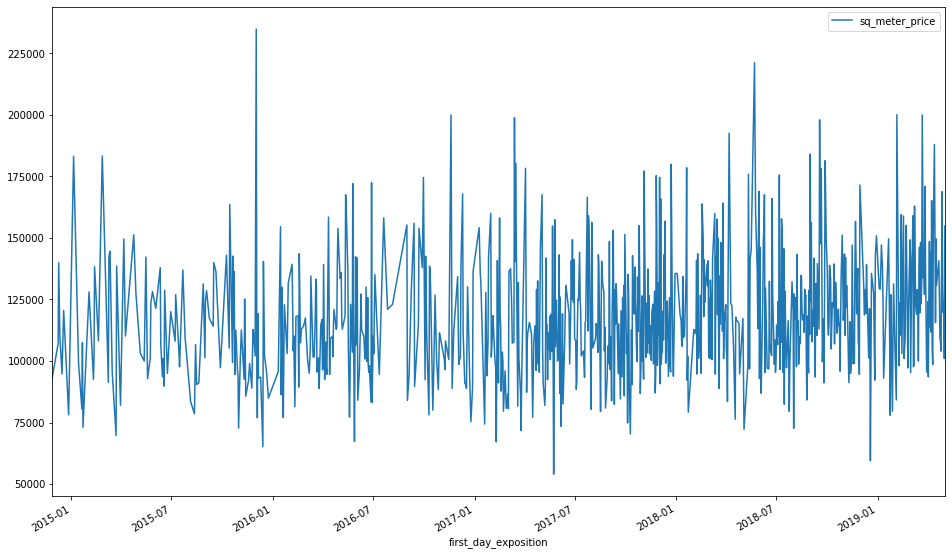

In [75]:
dependace_date_sqmp = cityCenter_flats.pivot_table(index='first_day_exposition', values='sq_meter_price')
dependace_date_sqmp.plot(figsize=(16,10))

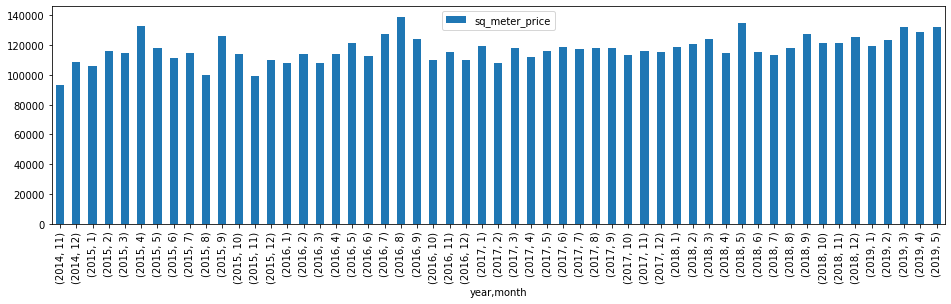

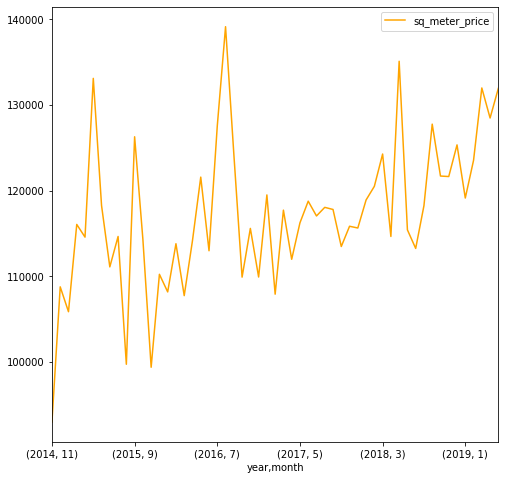

In [76]:
dependace_date_sqmp = cityCenter_flats.pivot_table(index=('year', 'month'), values='sq_meter_price')
dependace_date_sqmp.plot(kind='bar', figsize=(16,4))
dependace_date_sqmp.plot(color='orange', figsize=(8,8))

На втором графике видно, что общий тренд идет на увеличение стоимости за квадратный метр жилья. Иногда бывают локальные пики, которые скорее всего связанны с экономической обстановкой.

<div style="border:solid green 2px; padding: 20px"> <h1 style="color:green; margin-bottom:20px">Комментарий ревьювера</h1>
<div class="alert alert-block alert-success">
<b>Все ОК:</b> Молодец, анализ квартир размещенных в центре проведен в полном объеме!
</div> 

<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b> Стоит дополнительно поработать с оформлением визуализаций - метки времени на графики слились, что затрудняет его чтение, в данном случае можно применить метод plt.xticks, задав в параметре rotation - угол поворота подписи. Подробнее:
    
- https://matplotlib.org/3.1.1/gallery/ticks_and_spines/ticklabels_rotation.html

### Шаг 5. Общий вывод
<a class="anchor" id="six-bullet"></a>

Для объективной оценки общего рынка недвижимости следует брать данные, которые будут содержать как можно больше информации по самым распространенным объектам на рынке. Поэтому нам пришлось отсечь все данные, которые составляли скорее выбросы и могли повлиять на выводы при анализе. 
Очищенные данные более репрезентативны и по ним мы можем сформулировать следующие выводы:
- Данные всегда требуют перепроверки. И те, которые вносит человек, и те, которые полученны автоматически
- Цена за квадратный метр уменьшается с ростом площади продаваемого помещения
- Крайние этажи (первый, последний) стоят дешевле
- Анализ временных данных показывает, что есть общий тренд на рост цены на недвижимость, с локальными просадками и скачками
- Очистка данных занимает очень много времени
- Не все данные требуется заполнять. Пропуски бывают значимы не меньше.


<div style="border:solid yellow 2px; padding: 20px"> <h1 style="color:orange; margin-bottom:20px">Итоговый комментарий </h1>
<div class="alert alert-block alert-warning">
<b>Можно улучшить:</b> Поздравляю ты дошел до конца втогоро проекта! Проект выполнен достаточно хорошо у тебя явно есть понимание применяемых для анализа данных инструментов, в том числе визуализаций. Но есть несколько нюансов на которые я бы хотел обратить твое внимание:

1. Работа достаточно хорошо структурирована, все этапы выдлены и пронумерованы, однако на некоторых шагах есть небольшая путница, где-то ты проводишь анализ для полной стоимости квартиры, в некоторых для цены квадратного метра, некоторые зависимости для этих параметров могут быть противоположными, поэтому стоит проводить анализ для обоих величин или для одной из них (в задании говориться про полную цену квартиры).
    
    
2. Оформление графиков - ты использовал действительно куртые виды графиков, опережающие программу данного курса, но не забывай, что графики нужно оформлять соответствующим образом делая их более понятными и читаемыми для пользователей в чести подписей данных по осям и заголовков графиков.
    
    
В остально все хорошо! Надеюсь мои комментарии будут тебе полезными и я уверен, что  Удачи!

### Чек-лист готовности проекта

Поставьте 'x' в выполненных пунктах. Далее нажмите Shift+Enter.

- [x]  открыт файл
- [x]  файлы изучены (выведены первые строки, метод info())
- [x]  определены пропущенные значения
- [x]  заполнены пропущенные значения
- [x]  есть пояснение, какие пропущенные значения обнаружены
- [x]  изменены типы данных
- [x]  есть пояснение, в каких столбцах изменены типы и почему
- [x]  посчитано и добавлено в таблицу: цена квадратного метра
- [x]  посчитано и добавлено в таблицу: день недели, месяц и год публикации объявления
- [x]  посчитано и добавлено в таблицу: этаж квартиры; варианты — первый, последний, другой
- [x]  посчитано и добавлено в таблицу: соотношение жилой и общей площади, а также отношение площади кухни к общей
- [x]  изучены следующие параметры: площадь, цена, число комнат, высота потолков
- [x]  построены гистограммы для каждого параметра
- [x]  выполнено задание: "Изучите время продажи квартиры. Постройте гистограмму. Посчитайте среднее и медиану. Опишите, сколько обычно занимает продажа. Когда можно считать, что продажи прошли очень быстро, а когда необычно долго?"
- [x]  выполнено задание: "Уберите редкие и выбивающиеся значения. Опишите, какие особенности обнаружили."
- [x]  выполнено задание: "Какие факторы больше всего влияют на стоимость квартиры? Изучите, зависит ли цена от площади, числа комнат, удалённости от центра. Изучите зависимость цены от того, на каком этаже расположена квартира: первом, последнем или другом. Также изучите зависимость от даты размещения: дня недели, месяца и года. 
- [x]  выполнено задание: "Выберите 10 населённых пунктов с наибольшим числом объявлений. Посчитайте среднюю цену квадратного метра в этих населённых пунктах. Выделите населённые пункты с самой высокой и низкой стоимостью жилья. Эти данные можно найти по имени в столбце '*locality_name'*. "
- [x]  выполнено задание: "Изучите предложения квартир: для каждой квартиры есть информация о расстоянии до центра. Выделите квартиры в Санкт-Петербурге (*'locality_name'*). Ваша задача — выяснить, какая область входит в центр. Создайте столбец с расстоянием до центра в километрах: округлите до целых значений. После этого посчитайте среднюю цену для каждого километра. Постройте график: он должен показывать, как цена зависит от удалённости от центра. Определите границу, где график сильно меняется — это и будет центральная зона. "
- [x]  выполнено задание: "Выделите сегмент квартир в центре. Проанализируйте эту территорию и изучите следующие параметры: площадь, цена, число комнат, высота потолков. Также выделите факторы, которые влияют на стоимость квартиры (число комнат, этаж, удалённость от центра, дата размещения объявления). Сделайте выводы. Отличаются ли они от общих выводов по всему городу?"
- [x]  в каждом этапе есть выводы
- [x]  есть общий вывод